# **Vocal Alphabets BISINDO Object Detection**


*   Object detection contains 5 class, namely: A, I, U, E, O
*   The model using transfer learning *ssd-mobilenet-v2-fpnlite-320*
*   The Dataset created by own and using image augmentation such as color shifting






In [ ]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


## **Clone Tensorflow Models Github**

In [ ]:
import os

os.chdir('/content/drive/MyDrive/CAPSTONE')
#clone tensorflow models from github
!git clone --depth 1 https://github.com/tensorflow/models #already cloned

Cloning into 'models'...
remote: Enumerating objects: 3851, done.
remote: Counting objects: 100% (3851/3851), done.
remote: Compressing objects: 100% (2958/2958), done.
remote: Total 3851 (delta 1113), reused 1954 (delta 842), pack-reused 0
Receiving objects: 100% (3851/3851), 49.59 MiB | 15.57 MiB/s, done.
Resolving deltas: 100% (1113/1113), done.
Updating files: 100% (3493/3493), done.


In [ ]:
%%bash
cd /content/drive/MyDrive/CAPSTONE/models/research
protoc object_detection/protos/*.proto --python_out=.

In [ ]:
# Modify setup.py file to install the tf-models-official repository targeted at TF v2.8.0
import re
with open('/content/drive/MyDrive/CAPSTONE/models/research/object_detection/packages/tf2/setup.py') as f:
    s = f.read()

with open('/content/drive/MyDrive/CAPSTONE/models/research/setup.py', 'w') as f:
    # Set fine_tune_checkpoint path
    s = re.sub('tf-models-official>=2.5.1',
               'tf-models-official==2.8.0', s)
    f.write(s)

**Install Tensorflow Object Detection**

In [ ]:
!pip install '/content/drive/MyDrive/CAPSTONE/models/research/'

#downgrade tfod version to v2.8.0
!pip install tensorflow==2.8.0

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Processing ./drive/MyDrive/CAPSTONE/models/research
  Preparing metadata (setup.py) ... done
  Created wheel for object-detection: filename=object_detection-0.1-py3-none-any.whl size=1696981 sha256=c8e1683b6cf042fbfc5e9d908f8c0ecddcc35f6ae3ac0ed3c07007351ac8420c
  Stored in directory: /tmp/pip-ephem-wheel-cache-joosyzqh/wheels/69/ba/34/932a81801e52e47eeb7d85d1200ddfca647427c79fe9db1913
Successfully built object-detection
  Attempting uninstall: object-detection
    Found existing installation: object-detection 0.1
    Uninstalling object-detection-0.1:
      Successfully uninstalled object-detection-0.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
#run model builder
!python /content/drive/MyDrive/CAPSTONE/models/research/object_detection/builders/model_builder_tf2_test.py


/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl5mutexC1Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZNK10tensorflow4data11DatasetBase8FinalizeEPNS_15OpKernelContextESt8functionIFN3tsl8StatusOrISt10u

## **Split Dataset**



*   the dataset will be splitted into 80% training: 19% validation : 1% test
*   test set will be used for inference (to test if the model is classified properly)



In [ ]:
#current directory
import os
current_directory = os.getcwd()
current_directory

'/content'

In [ ]:
!cp '/content/drive/MyDrive/CAPSTONE/Dataset/semua.zip' /content

In [ ]:
!mkdir /content/drive/MyDrive/CAPSTONE/Images
!unzip -q semua.zip -d /content/drive/MyDrive/CAPSTONE/Images/all

**Checking the dataset**

In [ ]:
root_dir = '/content/drive/MyDrive/CAPSTONE/Images/all/semua'
root_dir

'/content/drive/MyDrive/CAPSTONE/Images/all/semua'

In [ ]:
root_dir = '/content/drive/MyDrive/CAPSTONE/Images/all/semua'
jpg_count = 0
xml_count = 0

for file in os.listdir(root_dir):
    if file.lower().endswith(('.jpg', '.jpeg')):
        jpg_count += 1
    elif file.endswith('.xml'):
        xml_count += 1

print(f"There are a total of {jpg_count} JPG images and {xml_count} XML files in the folder.")

There are a total of 5065 JPG images and 5065 XML files in the folder.


In [ ]:
# import string
# import os

# for letter in string.ascii_uppercase:
#   source_path = os.path.join(root_dir, letter)
#   try:
#     jpg_count = sum(1 for file in os.listdir(source_path) if file.lower().endswith(('.jpg','.jpeg')))
#     xml_count = sum(1 for file in os.listdir(source_path) if file.endswith('.xml'))
#     print(f"There are total {jpg_count} images and {xml_count} XML files in folder {letter}")
#   except FileNotFoundError:
#     pass

There are total 1040 images and 1040 XML files in folder A
There are total 1015 images and 1015 XML files in folder E
There are total 970 images and 970 XML files in folder I
There are total 1045 images and 1045 XML files in folder O
There are total 995 images and 995 XML files in folder U


**Create directory for training, validation, and test**

In [ ]:
#create directory for train, validation, and test
!mkdir /content/drive/MyDrive/CAPSTONE/Images/training; mkdir /content/drive/MyDrive/CAPSTONE/Images/validation; mkdir /content/drive/MyDrive/CAPSTONE/Images/test

In [ ]:
!python /content/drive/MyDrive/CAPSTONE/splitting.py

Total images: 5065
Images moving to train: 4052
Images moving to validation: 962
Images moving to test: 51


**Convert to CSV**

In [ ]:
!python3 /content/drive/MyDrive/CAPSTONE/create_csv.py

Successfully converted xml to csv.
Successfully converted xml to csv.


**Checking if splitting is worked properly**

In [ ]:
train_dir = '/content/drive/MyDrive/CAPSTONE/Images/training'
jpg_count = 0
xml_count = 0

for file in os.listdir(train_dir):
    if file.lower().endswith(('.jpg', '.jpeg')):
        jpg_count += 1
    elif file.endswith('.xml'):
        xml_count += 1

print(f"There are a total of {jpg_count} JPG images and {xml_count} XML files in the folder.")

There are a total of 4052 JPG images and 4052 XML files in the folder.


**Create Labelmap.txt**

In [ ]:
#create labelmap.txt
%%bash
cat <<EOF >> /content/drive/MyDrive/CAPSTONE/labelmap.txt
A
I
U
E
O
EOF

**Create TFRecords**

In [ ]:
#create tfrecord and labelmap.pbtxt
!python3 /content/drive/MyDrive/CAPSTONE/create_tfrecord.py --csv_input=/content/drive/MyDrive/CAPSTONE/Images/training_labels.csv --labelmap=/content/drive/MyDrive/CAPSTONE/labelmap.txt --image_dir=/content/drive/MyDrive/CAPSTONE/Images/training --output_path=/content/drive/MyDrive/CAPSTONE/train.tfrecord
!python3 /content/drive/MyDrive/CAPSTONE/create_tfrecord.py --csv_input=/content/drive/MyDrive/CAPSTONE/Images/validation_labels.csv --labelmap=/content/drive/MyDrive/CAPSTONE/labelmap.txt --image_dir=/content/drive/MyDrive/CAPSTONE/Images/validation --output_path=/content/drive/MyDrive/CAPSTONE/val.tfrecord

Traceback (most recent call last):
  File "/content/drive/MyDrive/CAPSTONE/create_tfrecord.py", line 108, in <module>
    tf.app.run()
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/platform/app.py", line 36, in run
    _run(main=main, argv=argv, flags_parser=_parse_flags_tolerate_undef)
  File "/usr/local/lib/python3.10/dist-packages/absl/app.py", line 308, in run
    _run_main(main, args)
  File "/usr/local/lib/python3.10/dist-packages/absl/app.py", line 254, in _run_main
    sys.exit(main(argv))
  File "/content/drive/MyDrive/CAPSTONE/create_tfrecord.py", line 86, in main
    tf_example = create_tf_example(group, path)
  File "/content/drive/MyDrive/CAPSTONE/create_tfrecord.py", line 34, in create_tf_example
    encoded_jpg = fid.read()
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/lib/io/file_io.py", line 114, in read
    self._preread_check()
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/lib/io/file_io.py", line 76, in _pr

In [ ]:
#define directory
train_record_fname = '/content/drive/MyDrive/CAPSTONE/train.tfrecord'
val_record_fname = '/content/drive/MyDrive/CAPSTONE/val.tfrecord'
label_map_pbtxt_fname = '/content/drive/MyDrive/CAPSTONE/labelmap.pbtxt'

## **Setup Transfer Learning Model**

In [ ]:
# Change the chosen_model variable to deploy different models available in the TF2 object detection zoo
chosen_model = 'ssd-mobilenet-v2-fpnlite-320'

MODELS_CONFIG = {
    'ssd-mobilenet-v2': {
        'model_name': 'ssd_mobilenet_v2_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz',
    },
    'efficientdet-d0': {
        'model_name': 'efficientdet_d0_coco17_tpu-32',
        'base_pipeline_file': 'ssd_efficientdet_d0_512x512_coco17_tpu-8.config',
        'pretrained_checkpoint': 'efficientdet_d0_coco17_tpu-32.tar.gz',
    },
    'ssd-mobilenet-v2-fpnlite-320': {
        'model_name': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz',
    }
}

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']

In [ ]:
%mkdir /content/drive/MyDrive/CAPSTONE/models/newmodel/
%cd /content/drive/MyDrive/CAPSTONE/models/newmodel/

# Download pre-trained model weights
import tarfile
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint
!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

# Download training configuration file for model
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/content/drive/MyDrive/CAPSTONE/models/newmodel
--2023-06-08 09:09:03--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 108.177.98.128, 2607:f8b0:400e:c0d::80
Connecting to download.tensorflow.org (download.tensorflow.org)|108.177.98.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20515344 (20M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_fp 100%[===================>]  19.56M  86.3MB/s    in 0.2s    

2023-06-08 09:09:03 (86.3 MB/s) - ‘ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz’ saved [20515344/20515344]

--2023-06-08 09:09:03--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109

In [ ]:
os.chdir('/content')
current_directory = os.getcwd()
current_directory

'/content'

In [ ]:
# Set training parameters for the model
num_steps = 40000

if chosen_model == 'efficientdet-d0':
  batch_size = 4
else:
  batch_size = 16

In [ ]:
# Set file locations and get number of classes for config file
pipeline_fname = '/content/drive/MyDrive/CAPSTONE/models/newmodel/' + base_pipeline_file
fine_tune_checkpoint = '/content/drive/MyDrive/CAPSTONE/models/newmodel/' + model_name + '/checkpoint/ckpt-0'

def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_pbtxt_fname)
print('Total classes:', num_classes)

Total classes: 5


In [ ]:
# Create custom configuration file by writing the dataset, model checkpoint, and training parameters into the base pipeline file
import re

%cd /content/drive/MyDrive/CAPSTONE/models/newmodel
print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()
with open('pipeline_file.config', 'w') as f:

    # Set fine_tune_checkpoint path
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint), s)

    # Set tfrecord files for train and test datasets
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/train)(.*?")', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub(
        '(input_path: ".*?)(PATH_TO_BE_CONFIGURED/val)(.*?")', 'input_path: "{}"'.format(val_record_fname), s)

    # Set label_map_path
    s = re.sub(
        'label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_pbtxt_fname), s)

    # Set batch_size
    s = re.sub('batch_size: [0-9]+',
               'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+',
               'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes
    s = re.sub('num_classes: [0-9]+',
               'num_classes: {}'.format(num_classes), s)

    # Change fine-tune checkpoint type from "classification" to "detection"
    s = re.sub(
        'fine_tune_checkpoint_type: "classification"', 'fine_tune_checkpoint_type: "{}"'.format('detection'), s)

    # If using ssd-mobilenet-v2, reduce learning rate (because it's too high in the default config file)
    if chosen_model == 'ssd-mobilenet-v2':
      s = re.sub('learning_rate_base: .8',
                 'learning_rate_base: .08', s)

      s = re.sub('warmup_learning_rate: 0.13333',
                 'warmup_learning_rate: .026666', s)

    # If using efficientdet-d0, use fixed_shape_resizer instead of keep_aspect_ratio_resizer (because it isn't supported by TFLite)
    if chosen_model == 'efficientdet-d0':
      s = re.sub('keep_aspect_ratio_resizer', 'fixed_shape_resizer', s)
      s = re.sub('pad_to_max_dimension: true', '', s)
      s = re.sub('min_dimension', 'height', s)
      s = re.sub('max_dimension', 'width', s)

    f.write(s)


/content/drive/MyDrive/CAPSTONE/models/newmodel
writing custom configuration file


In [ ]:
#checking the pipelines
!cat /content/drive/MyDrive/CAPSTONE/models/newmodel/pipeline_file.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 22.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 5
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator {

In [ ]:
# Set the path for custom config file and the directory to store training checkpoints in
pipeline_file = '/content/drive/MyDrive/CAPSTONE/models/newmodel/pipeline_file.config'
!mkdir /content/drive/MyDrive/CAPSTONE/history_model
model_dir = '/content/drive/MyDrive/CAPSTONE/history_model'

mkdir: cannot create directory ‘/content/drive/MyDrive/CAPSTONE/history_model’: File exists


## **Training the Models**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir '/content/drive/MyDrive/CAPSTONE/history_model/train'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 65797), started 0:00:29 ago. (Use '!kill 65797' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# Run training!
!python /content/drive/MyDrive/CAPSTONE/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1

/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl5mutexC1Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZNK10tensorflow4data11DatasetBase8FinalizeEPNS_15OpKernelContextESt8functionIFN3tsl8StatusOrISt10u

In [ ]:
# Make a directory to store the trained TFLite model
!mkdir /content/drive/MyDrive/CAPSTONE/tflite_model
output_directory = '/content/drive/MyDrive/CAPSTONE/tflite_model'

# Path to training directory (the conversion script automatically chooses the highest checkpoint file)
last_model_path = '/content/drive/MyDrive/CAPSTONE/history_model'

!python /content/drive/MyDrive/CAPSTONE/models/research/object_detection/export_tflite_graph_tf2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}


/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:98: UserWarning: unable to load libtensorflow_io_plugins.so: unable to open file: libtensorflow_io_plugins.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io_plugins.so: undefined symbol: _ZN3tsl5mutexC1Ev']
  warnings.warn(f"unable to load libtensorflow_io_plugins.so: {e}")
/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/__init__.py:104: UserWarning: file system plugins are not loaded: unable to open file: libtensorflow_io.so, from paths: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so']
caused by: ['/usr/local/lib/python3.10/dist-packages/tensorflow_io/python/ops/libtensorflow_io.so: undefined symbol: _ZNK10tensorflow4data11DatasetBase8FinalizeEPNS_15OpKernelContextESt8functionIFN3tsl8StatusOrISt10u

## **Export the model with TFLite**

In [ ]:
# Convert exported graph file into TFLite model file
import tensorflow as tf

converter = tf.lite.TFLiteConverter.from_saved_model('/content/drive/MyDrive/CAPSTONE/tflite_model/saved_model')
tflite_model = converter.convert()

with open('/content/drive/MyDrive/CAPSTONE/tflite_model/BISINDO.tflite', 'wb') as f:
  f.write(tflite_model)

In [ ]:

#this script from Edje Electronics
# Source: https://github.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/blob/master/TFLite_detection_image.py

# Import packages
import os
import cv2
import numpy as np
import sys
import glob
import random
import importlib.util
from tensorflow.lite.python.interpreter import Interpreter

import matplotlib
import matplotlib.pyplot as plt

%matplotlib inline

### Define function for inferencing with TFLite model and displaying results

def tflite_detect_images(modelpath, imgpath, lblpath, min_conf=0.5, num_test_images=10, savepath='/content/drive/MyDrive/CAPSTONE/results', txt_only=False):

  # take filenames of all images in test folder
  images = glob.glob(imgpath + '/*.jpg') + glob.glob(imgpath + '/*.JPG') + glob.glob(imgpath + '/*.png') + glob.glob(imgpath + '/*.JPEG') + glob.glob(imgpath + '/*.bmp')

  # Load the label map into memory
  with open(lblpath, 'r') as f:
      labels = [line.strip() for line in f.readlines()]

  # Load the Tensorflow Lite model into memory
  interpreter = Interpreter(model_path=modelpath)
  interpreter.allocate_tensors()

  # Get model details
  input_details = interpreter.get_input_details()
  output_details = interpreter.get_output_details()
  height = input_details[0]['shape'][1]
  width = input_details[0]['shape'][2]

  float_input = (input_details[0]['dtype'] == np.float32)

  input_mean = 127.5
  input_std = 127.5

  # Randomly select test images
  images_to_test = random.sample(images, num_test_images)

  # Loop over every image and perform detection
  for image_path in images_to_test:

      # Load image and resize to expected shape [1xHxWx3]
      image = cv2.imread(image_path)
      image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
      imH, imW, _ = image.shape
      image_resized = cv2.resize(image_rgb, (width, height))
      input_data = np.expand_dims(image_resized, axis=0)

      # Normalize pixel values if using a floating model (i.e. if model is non-quantized)
      if float_input:
          input_data = (np.float32(input_data) - input_mean) / input_std

      # Perform the actual detection by running the model with the image as input
      interpreter.set_tensor(input_details[0]['index'],input_data)
      interpreter.invoke()

      # Retrieve detection results
      boxes = interpreter.get_tensor(output_details[1]['index'])[0] # Bounding box coordinates of detected objects
      classes = interpreter.get_tensor(output_details[3]['index'])[0] # Class index of detected objects
      scores = interpreter.get_tensor(output_details[0]['index'])[0] # Confidence of detected objects

      detections = []

      # Loop over all detections and draw detection box if confidence is above minimum threshold
      for i in range(len(scores)):
          if ((scores[i] > min_conf) and (scores[i] <= 1.0)):

              # Get bounding box coordinates and draw box
              # Interpreter can return coordinates that are outside of image dimensions, need to force them to be within image using max() and min()
              ymin = int(max(1,(boxes[i][0] * imH)))
              xmin = int(max(1,(boxes[i][1] * imW)))
              ymax = int(min(imH,(boxes[i][2] * imH)))
              xmax = int(min(imW,(boxes[i][3] * imW)))

              cv2.rectangle(image, (xmin,ymin), (xmax,ymax), (10, 255, 0), 2)

              # Draw label
              object_name = labels[int(classes[i])] # Look up object name from "labels" array using class index
              label = '%s: %d%%' % (object_name, int(scores[i]*100)) # Example: 'person: 72%'
              labelSize, baseLine = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 0.7, 2) # Get font size
              label_ymin = max(ymin, labelSize[1] + 10) # Make sure not to draw label too close to top of window
              cv2.rectangle(image, (xmin, label_ymin-labelSize[1]-10), (xmin+labelSize[0], label_ymin+baseLine-10), (255, 255, 255), cv2.FILLED) # Draw white box to put label text in
              cv2.putText(image, label, (xmin, label_ymin-7), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 0), 2) # Draw label text

              detections.append([object_name, scores[i], xmin, ymin, xmax, ymax])


      # All the results have been drawn on the image, now display the image
      if txt_only == False: # "text_only" controls whether we want to display the image results or just save them in .txt files
        image = cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        plt.figure(figsize=(12,16))
        plt.imshow(image)
        plt.show()

      # Save detection results in .txt files (for calculating mAP)
      elif txt_only == True:

        # Get filenames and paths
        image_fn = os.path.basename(image_path)
        base_fn, ext = os.path.splitext(image_fn)
        txt_result_fn = base_fn +'.txt'
        txt_savepath = os.path.join(savepath, txt_result_fn)

        # Write results to text file
        # (Using format defined by https://github.com/Cartucho/mAP, which will make it easy to calculate mAP)
        with open(txt_savepath,'w') as f:
            for detection in detections:
                f.write('%s %.4f %d %d %d %d\n' % (detection[0], detection[1], detection[2], detection[3], detection[4], detection[5]))

  return

## **Test the models with Test Images**

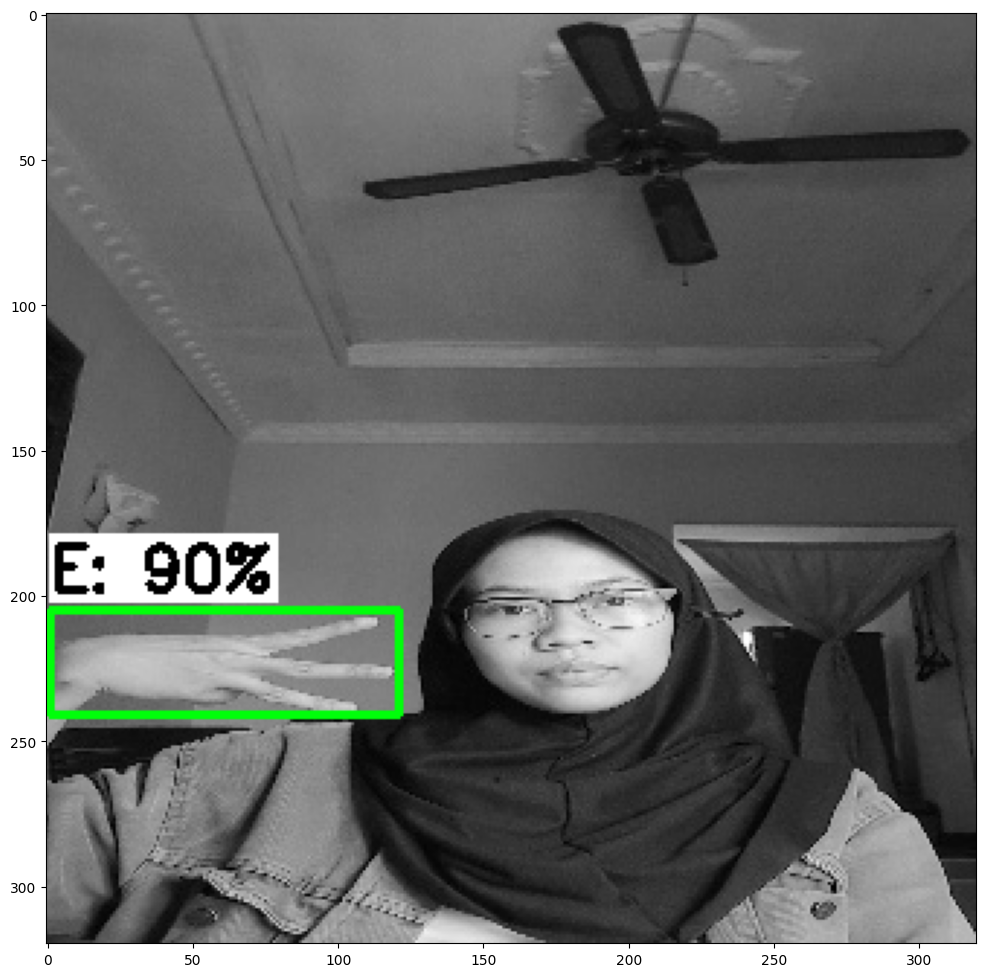

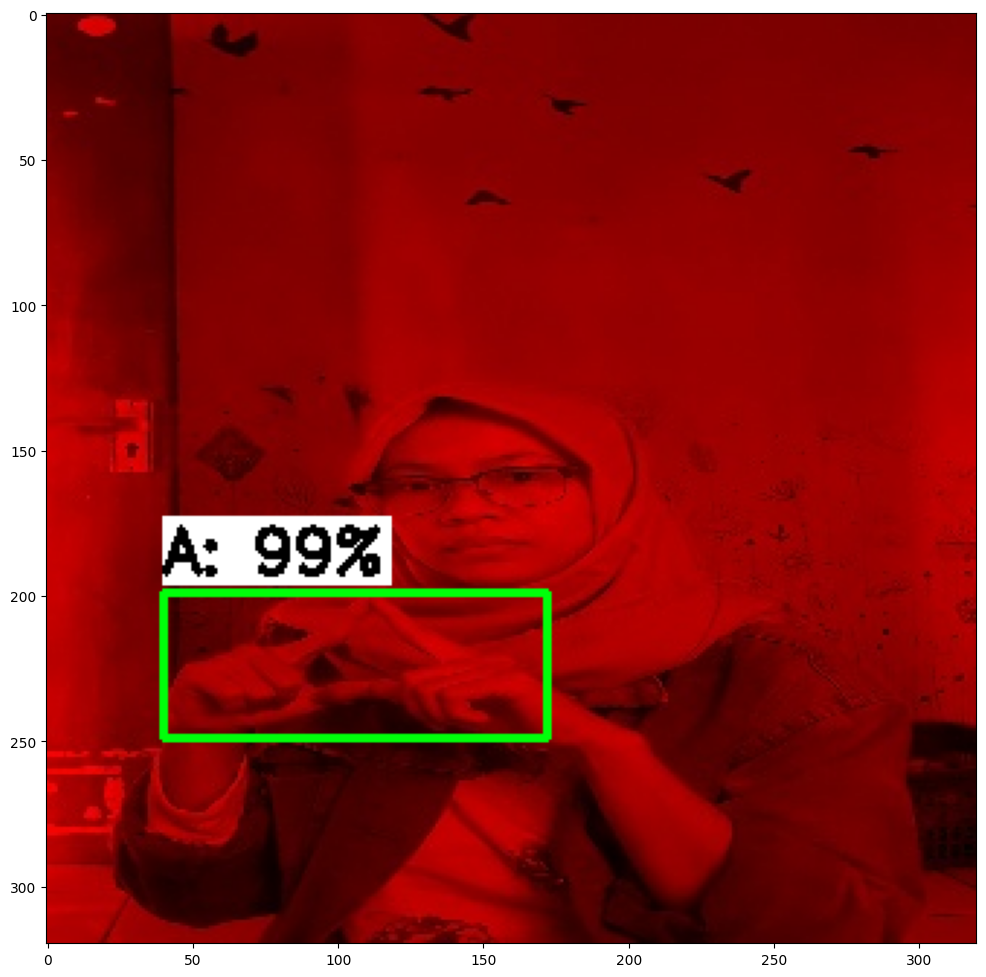

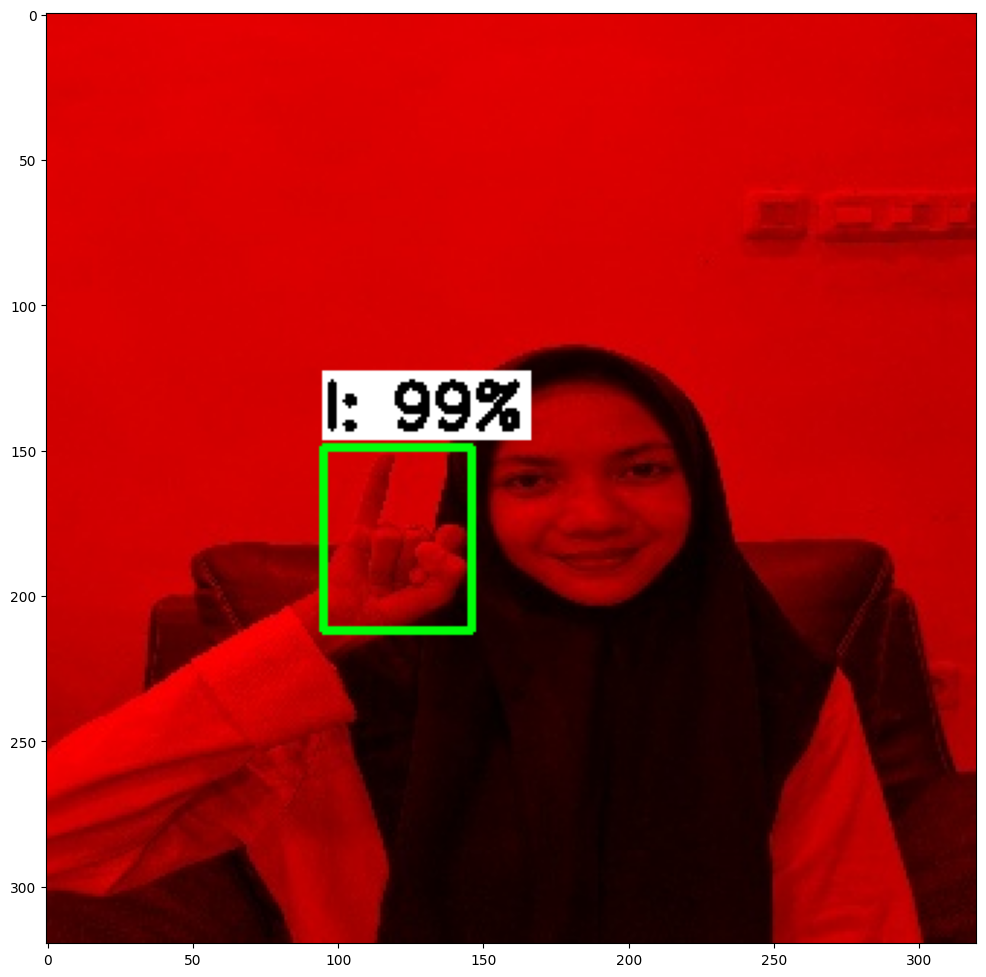

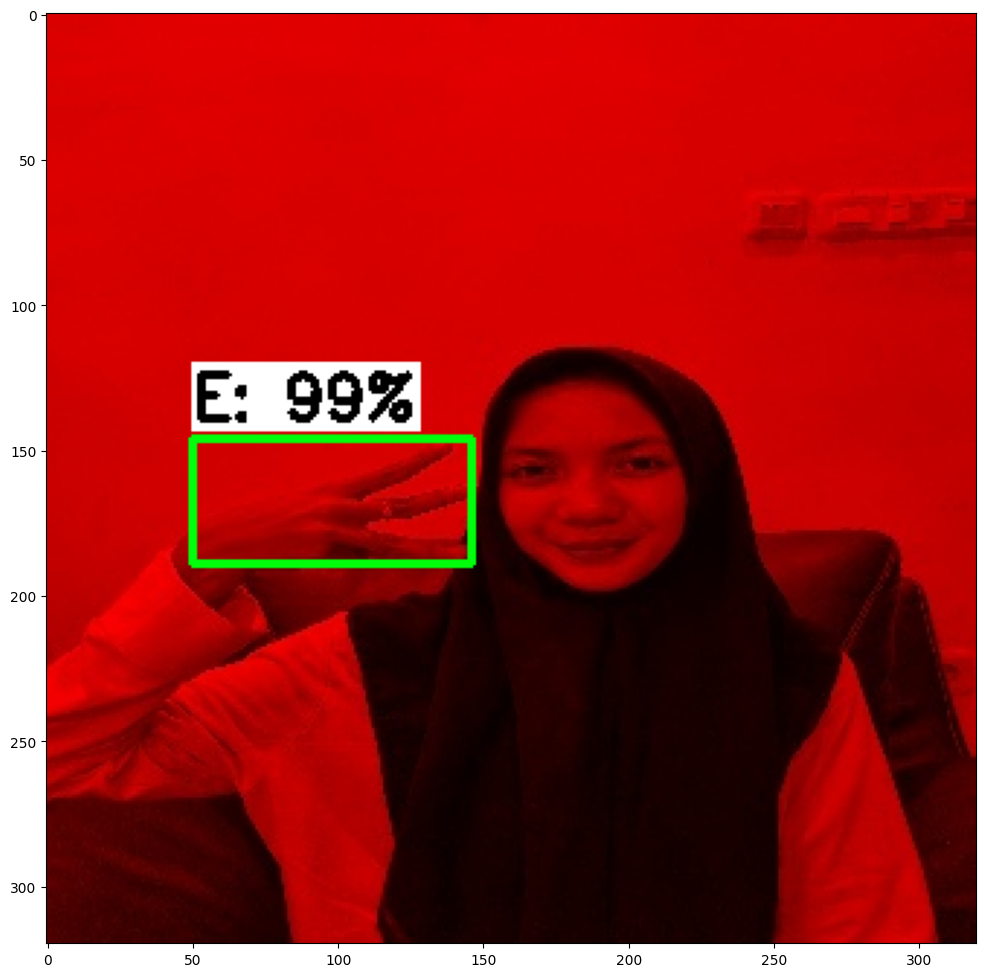

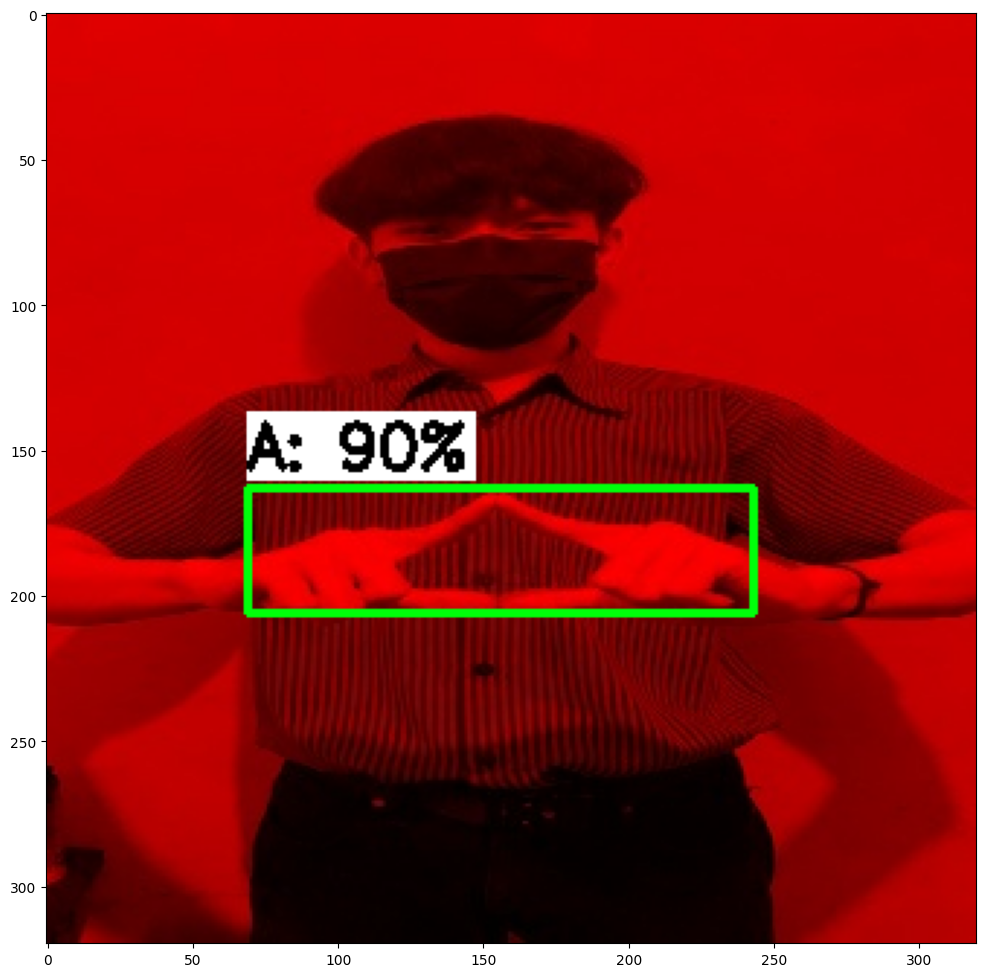

...

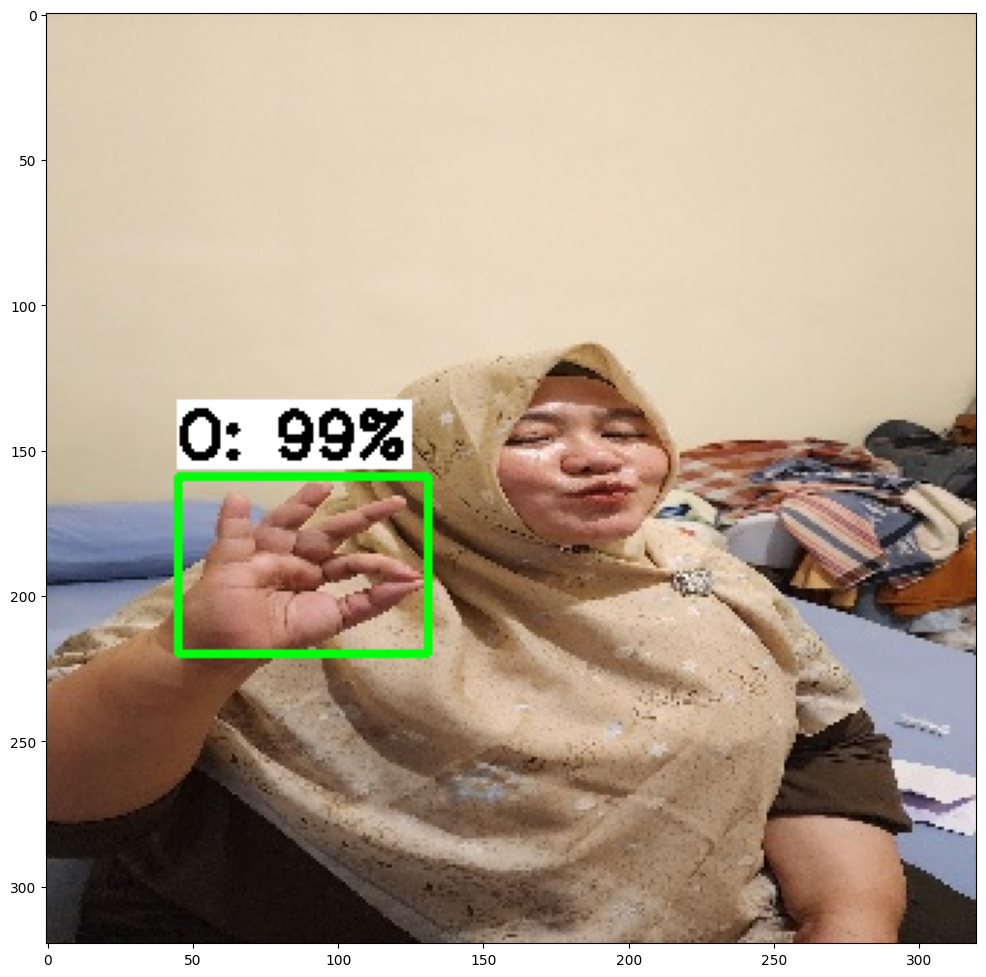

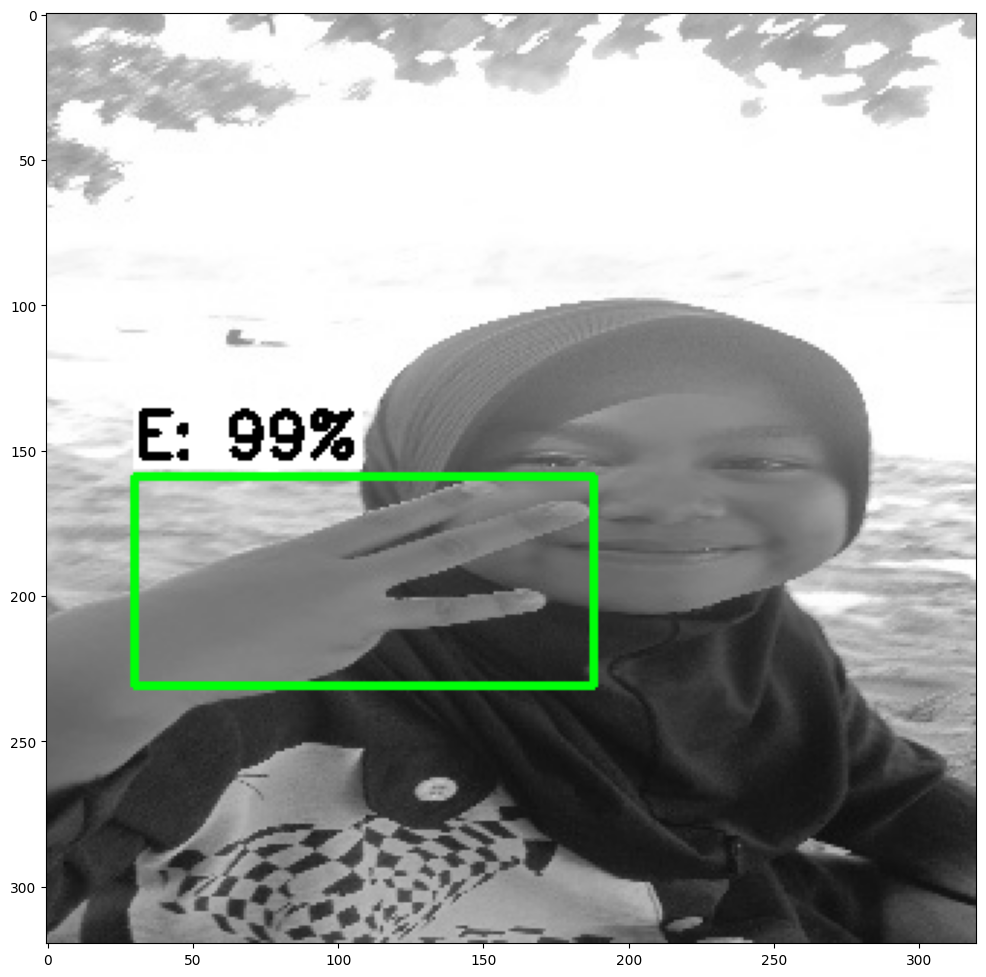

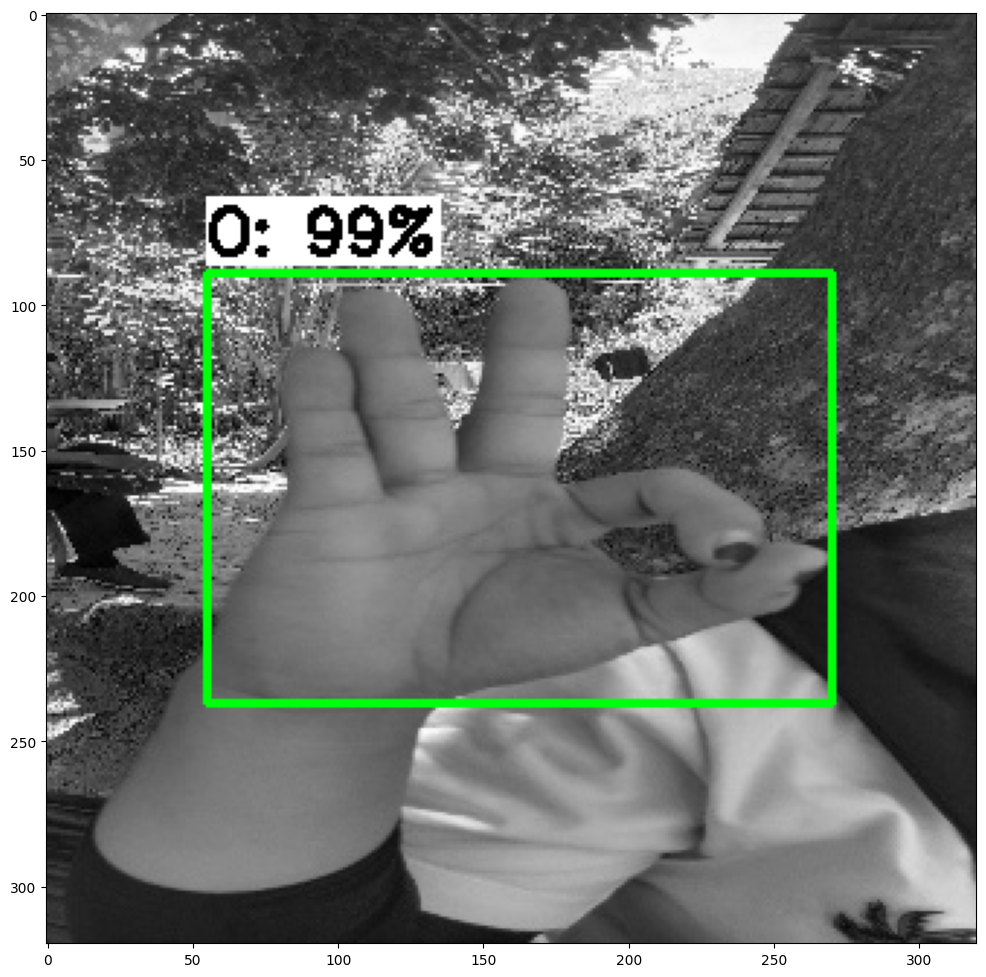

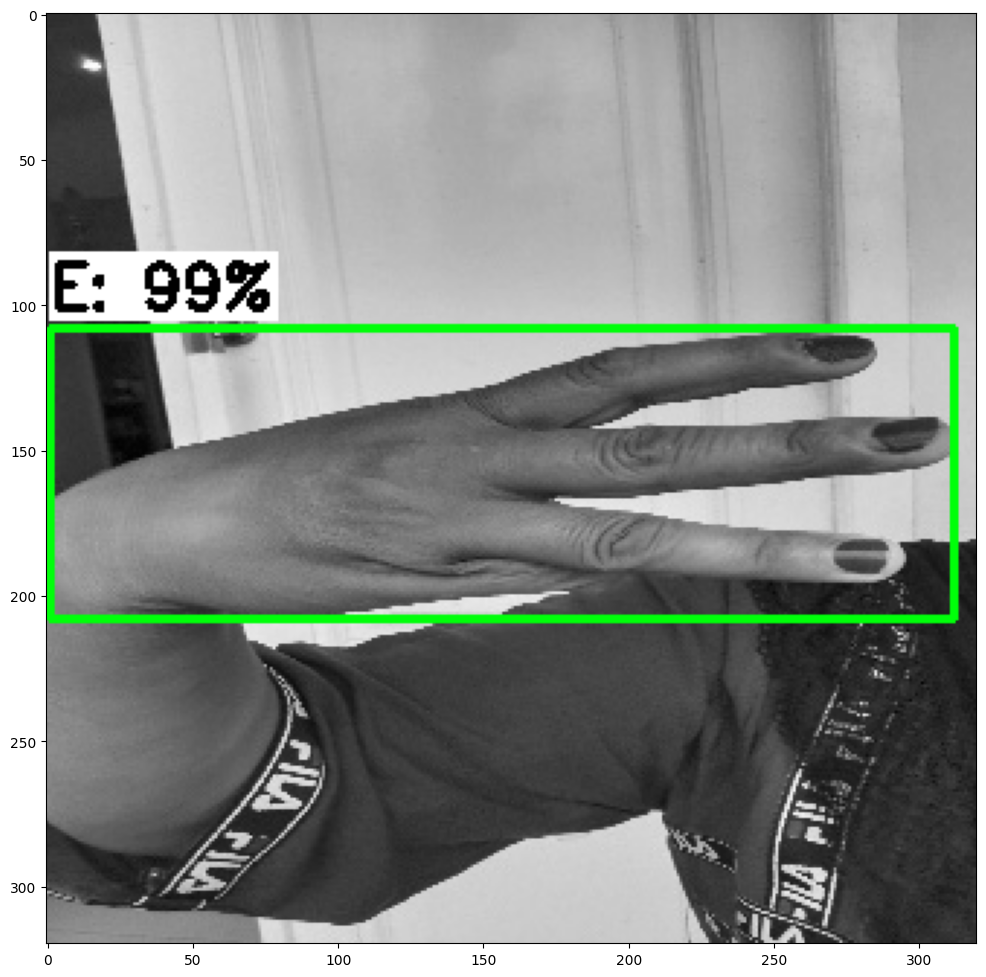

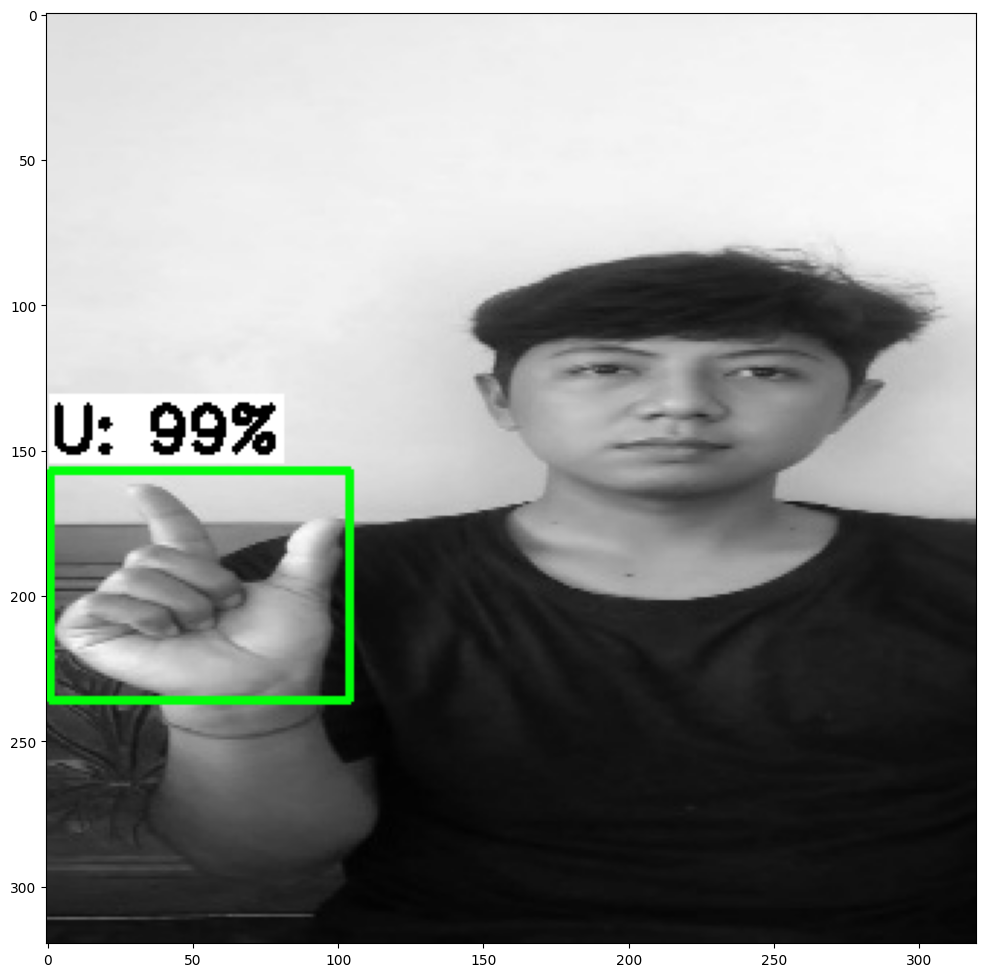

In [ ]:
# Set up variables for running user's model
PATH_TO_IMAGES='/content/drive/MyDrive/CAPSTONE/Images/test'   # Path to test images folder
PATH_TO_MODEL='/content/drive/MyDrive/CAPSTONE/tflite_model/BISINDO.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/drive/MyDrive/CAPSTONE/labelmap.txt'   # Path to labelmap.txt file
min_conf_threshold=0.5   # Confidence threshold (try changing this to 0.01 if you don't see any detection results)
images_to_test = 20   # Number of images to run detection on

# Run inferencing function!
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test)

## **Calculated Accuracy Model with mAP**



*   To calculate object detection accuracy we can use mAP or Mean Average Score (https://blog.roboflow.com/mean-average-precision/)
*   mAP is equal to the average of the Average Precision metric across all classes in a model. mAP can compare both different models on the same task and different versions of the same model
*   mAP calculator tool that used in this code created by https://github.com/Cartucho/mAP






In [ ]:
os.chdir('/content')

In [ ]:
%%bash
git clone https://github.com/Cartucho/mAP /content/mAP
cd /content/mAP
rm input/detection-results/*
rm input/ground-truth/*
rm input/images-optional/*
wget https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py

Cloning into '/content/mAP'...
--2023-06-08 12:59:21--  https://raw.githubusercontent.com/EdjeElectronics/TensorFlow-Lite-Object-Detection-on-Android-and-Raspberry-Pi/master/util_scripts/calculate_map_cartucho.py
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.109.133, 185.199.111.133, 185.199.108.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.109.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 5397 (5.3K) [text/plain]
Saving to: ‘calculate_map_cartucho.py’

     0K .....                                                 100% 60.7M=0s

2023-06-08 12:59:22 (60.7 MB/s) - ‘calculate_map_cartucho.py’ saved [5397/5397]



In [ ]:
!cp /content/drive/MyDrive/CAPSTONE/Images/test/* /content/mAP/input/images-optional # Copy images and xml files
!mv /content/mAP/input/images-optional/*.xml /content/mAP/input/ground-truth/  # Move xml files to the appropriate folder

In [ ]:
!python /content/mAP/scripts/extra/convert_gt_xml.py

Conversion completed!


In [ ]:
# Set up variables for running inference, this time to get detection results saved as .txt files
PATH_TO_IMAGES='/content/drive/MyDrive/CAPSTONE/Images/test'   # Path to test images folder
PATH_TO_MODEL='/content/drive/MyDrive/CAPSTONE/tflite_model/BISINDO.tflite'   # Path to .tflite model file
PATH_TO_LABELS='/content/drive/MyDrive/CAPSTONE/labelmap.txt'   # Path to labelmap.txt file
PATH_TO_RESULTS='/content/mAP/input/detection-results' # Folder to save detection results in
min_conf_threshold=0.1   # Confidence threshold

# Use all the images in the test folder
image_list = glob.glob(PATH_TO_IMAGES + '/*.jpg') + glob.glob(PATH_TO_IMAGES + '/*.JPG') + glob.glob(PATH_TO_IMAGES + '/*.png') + glob.glob(PATH_TO_IMAGES + '/*.bmp')
images_to_test = min(500, len(image_list)) # If there are more than 500 images in the folder, just use 500

# Tell function to just save results and not display images
txt_only = True

# Run inferencing function!
print('Starting inference on %d images...' % images_to_test)
tflite_detect_images(PATH_TO_MODEL, PATH_TO_IMAGES, PATH_TO_LABELS, min_conf_threshold, images_to_test, PATH_TO_RESULTS, txt_only)
print('Finished inferencing!')

Starting inference on 51 images...
Finished inferencing!


In [ ]:
%cd /content/mAP
!python calculate_map_cartucho.py --labels=/content/drive/MyDrive/CAPSTONE/labelmap.txt

/content/mAP
Calculating mAP at 0.50 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.55 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.60 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.65 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.70 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.75 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.80 IoU threshold...
100.00% = A AP 
100.00% = E AP 
100.00% = I AP 
100.00% = O AP 
100.00% = U AP 
mAP = 100.00%
Calculating mAP at 0.85 IoU threshold...
1

Overall accuracy for all of existing class is 95.29%

In [ ]:
#move mAP results in current directory
!mv /content/mAP /content/drive/MyDrive/CAPSTONE